# Advance lane detection

## *Import modules*

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
%matplotlib inline
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import pickle
import os

## *Find chessboard corners*

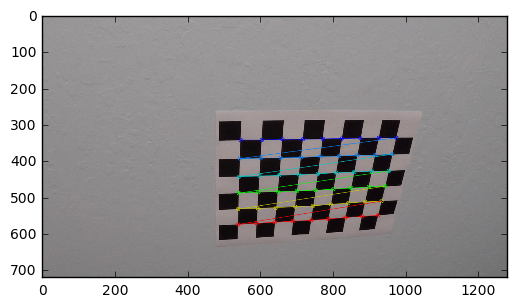

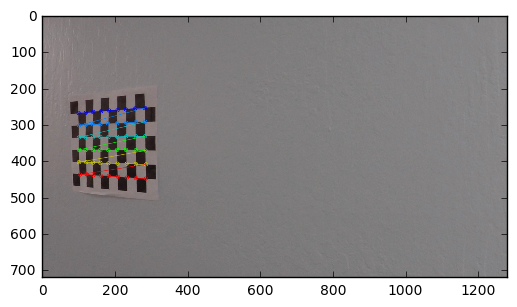

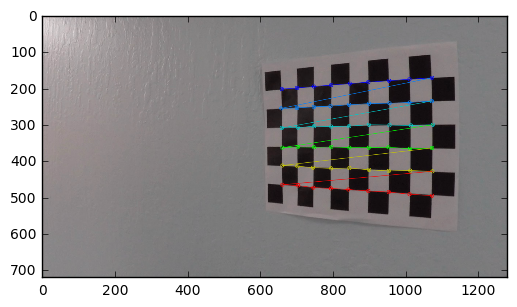

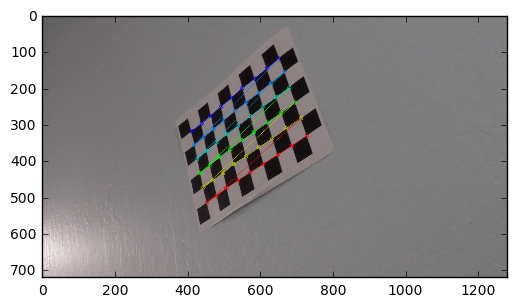

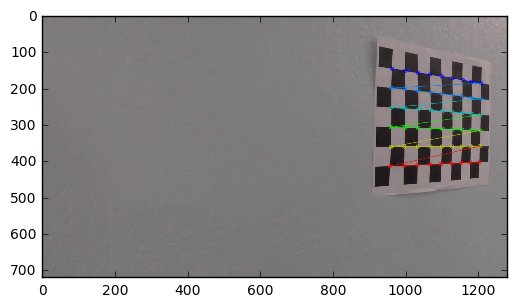

...

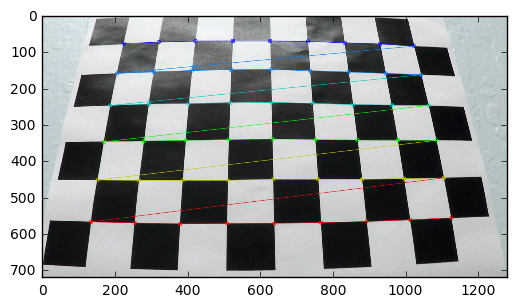

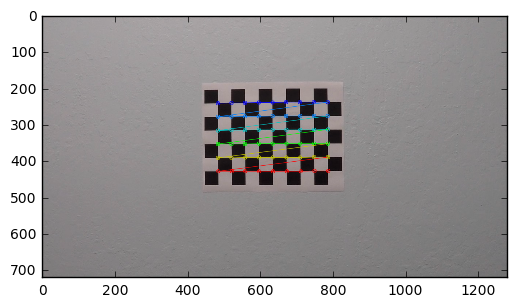

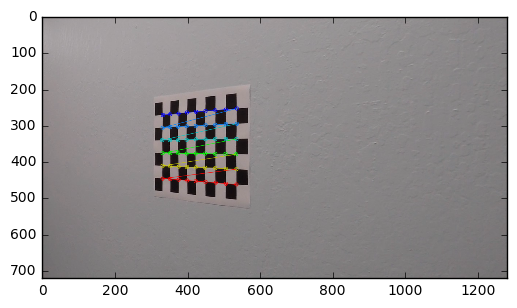

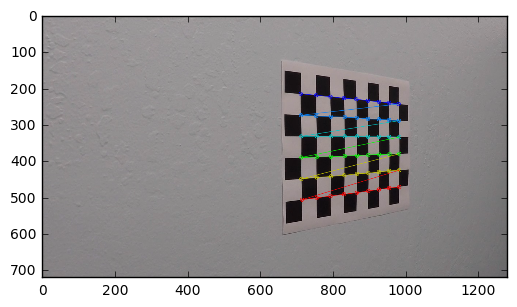

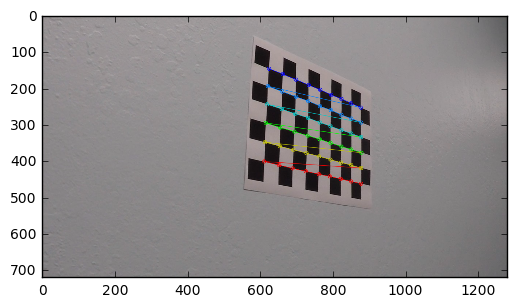

In [2]:
nx = 9
ny = 6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob(r'C:\Users\sbx1238\Documents\p4\CarND-Advanced-Lane-Lines\camera_cal\calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/res_chessboard/'
        write_name = path+'corners_found'+str(idx)+'.jpg'
        cv2.imwrite(write_name, img)
       
        plt.figure()
        plt.imshow(img)
        

## *Calibrate camera*

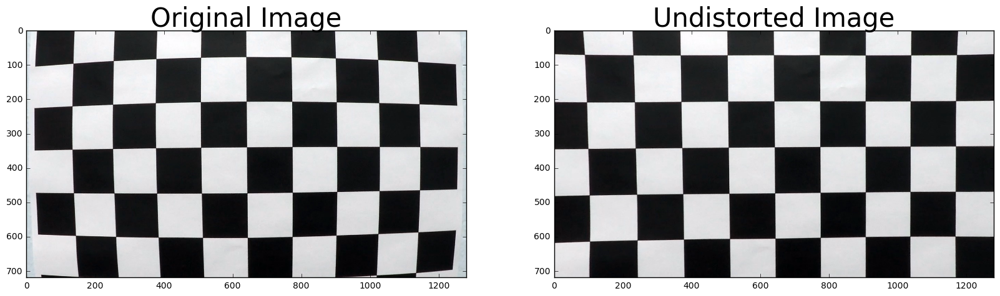

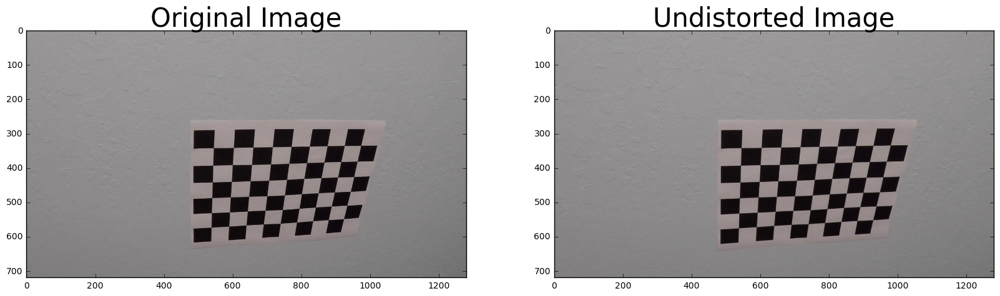

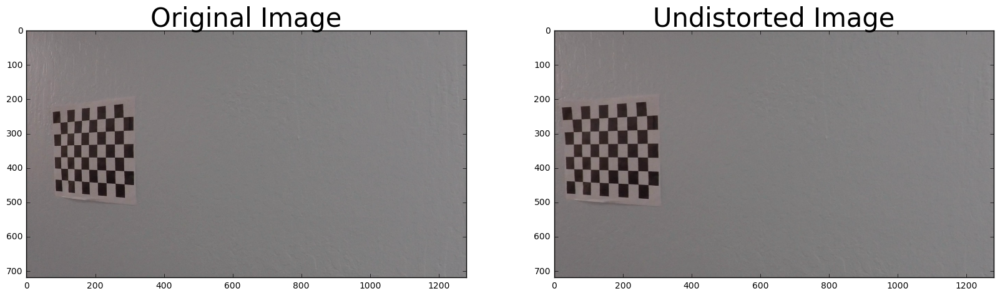

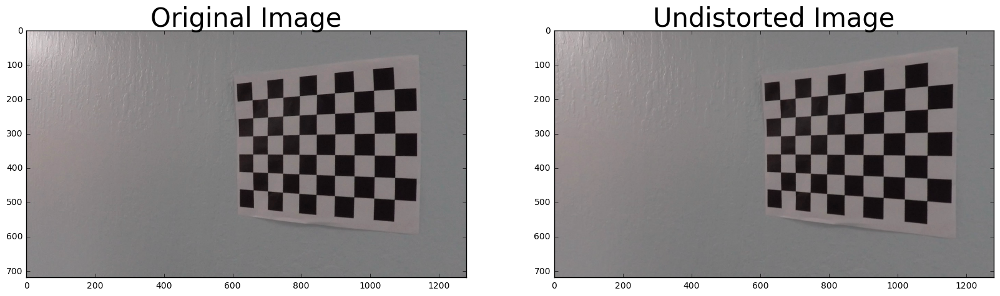

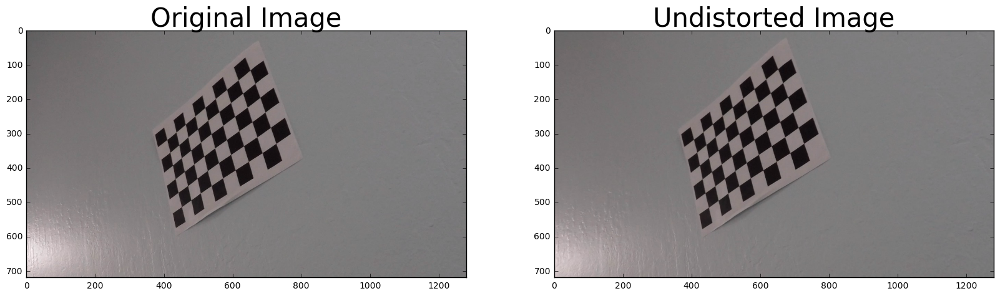

...

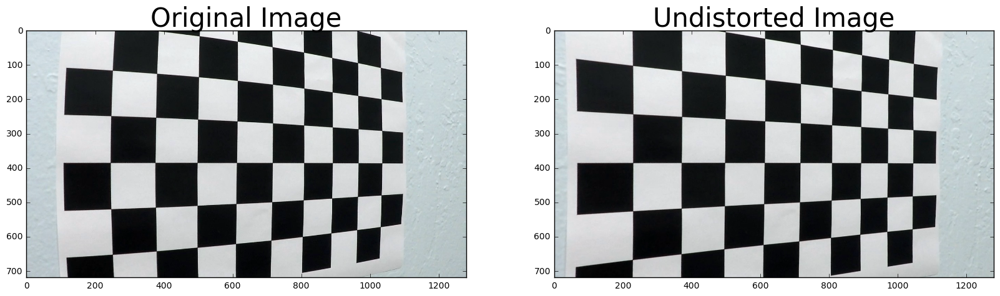

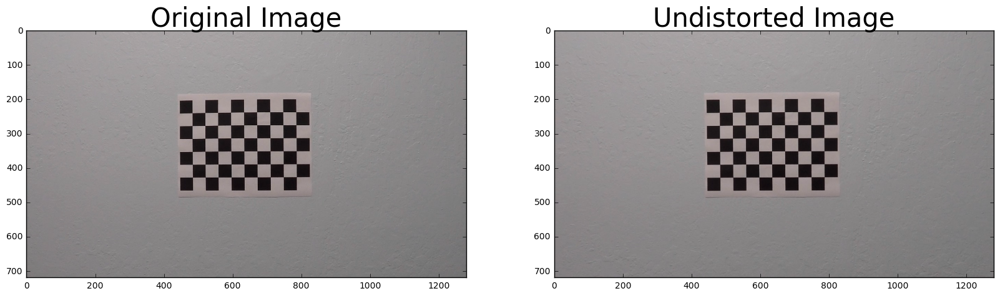

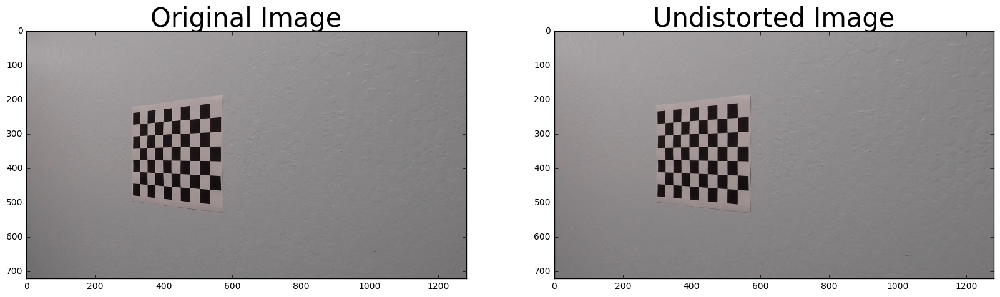

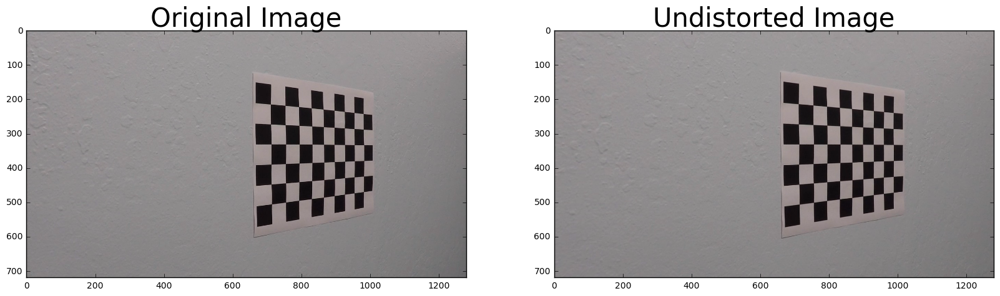

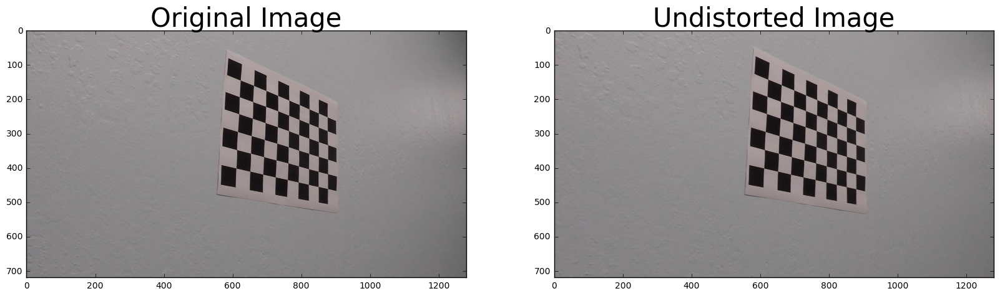

In [3]:
img = cv2.imread(r'C:\Users\sbx1238\Documents\p4\CarND-Advanced-Lane-Lines\camera_cal\calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
#dst = cv2.undistort(img, mtx, dist, None, mtx)

for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/res_camera_cal/'
    write_name = path+'undistorted'+str(idx)+'.jpg'
    cv2.imwrite(write_name, dst)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)

 ## *Read in test images*

In [4]:
os.listdir("test_images/")

['straight_lines1.jpg',
 'straight_lines2.jpg',
 'test1.jpg',
 'test2.jpg',
 'test3.jpg',
 'test4.jpg',
 'test5.jpg',
 'test6.jpg']

In [5]:
def read_image(image_path):
    return mpimg.imread(image_path)

In [6]:
# Read in the test images
test_images = [read_image('test_images/' + i) for i in os.listdir('test_images/')]

## *Distortion correction* 

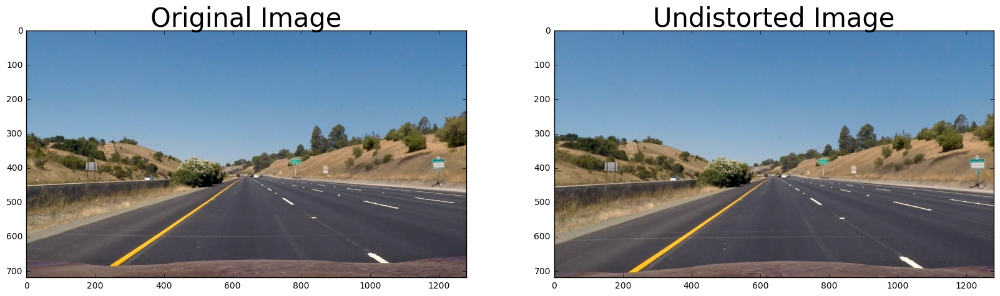

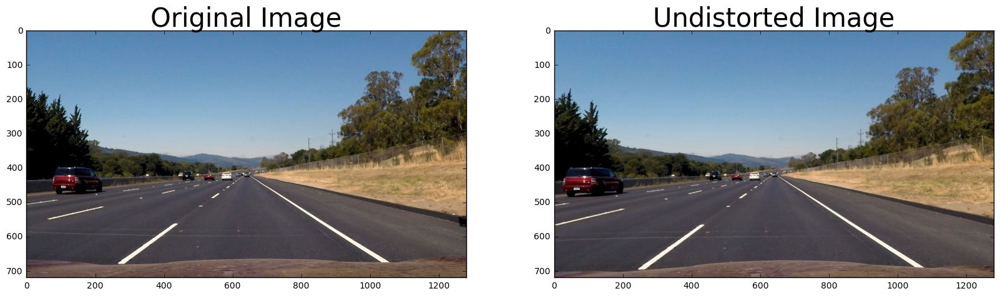

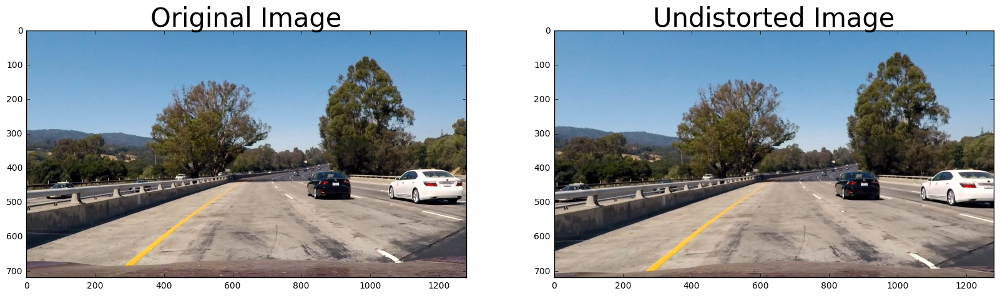

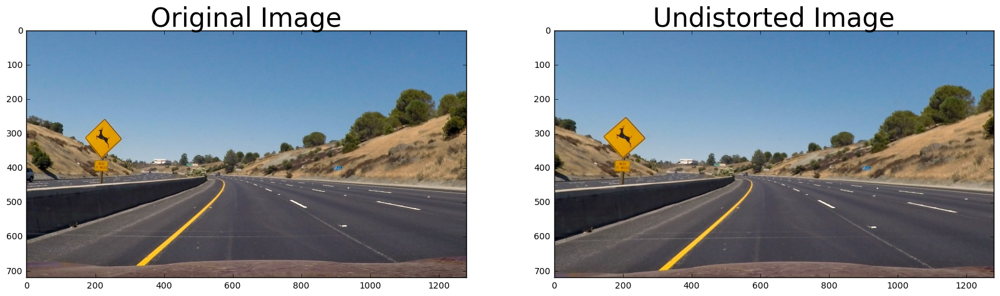

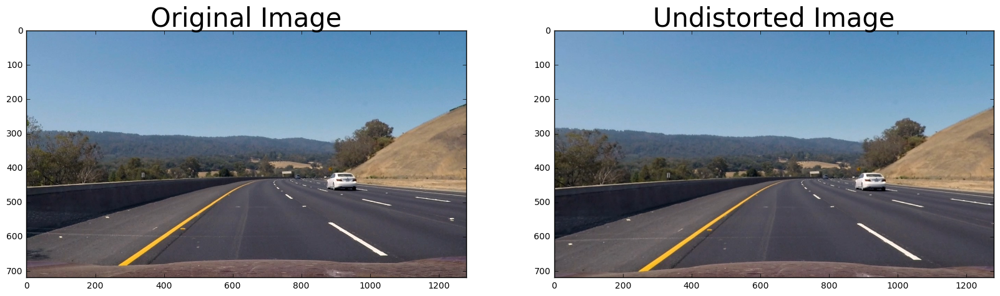

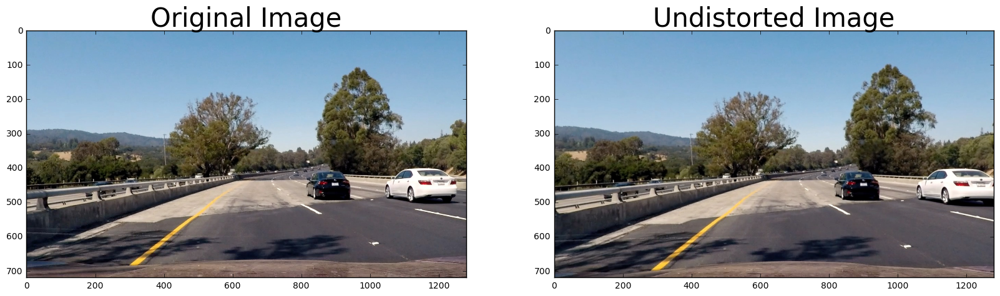

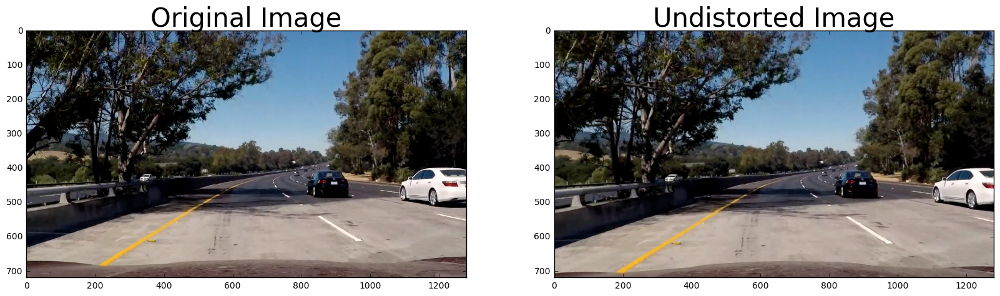

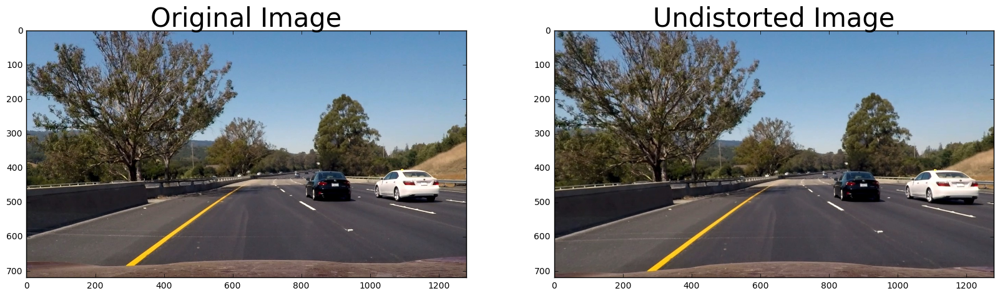

In [7]:
undist_images = []
for i in range(len(test_images)):
    image = test_images[i]
    undist_image = cv2.undistort(image, mtx, dist, None, mtx)
    undist_images.append(undist_image)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/undist_test_images/'
    write_name = path+'undistorted'+str(i)+'.jpg'
    mpimg.imsave(write_name, undist_image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist_image)
    ax2.set_title('Undistorted Image', fontsize=30)

## *Perspective transform*

In [8]:
def drawlines(image, points, color=[255, 0, 0], thickness=3):
    p1, p2, p3, p4 = points
    cv2.line(image, tuple(p1), tuple(p2), color, thickness)
    cv2.line(image, tuple(p2), tuple(p3), color, thickness)
    cv2.line(image, tuple(p3), tuple(p4), color, thickness)
    cv2.line(image, tuple(p4), tuple(p1), color, thickness)

In [9]:
def perspective_transform(image, debug=False, size_top=70, size_bottom=370,reverse=False,drawLines=False):
    height, width = image.shape[0:2]
    output_size = height/2
    
    if (reverse==False):
        src = np.float32([[298,662],[602,447],[683,447],[1020,662]])
        dst = np.float32([[280,700],[280,0],[920,0],[920,700]])
    else:
        dst = np.float32([[298,662],[602,447],[683,447],[1020,662]])
        src = np.float32([[280,700],[280,0],[920,0],[920,700]])
  
                
    
  
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(image, M, (width, height), flags=cv2.INTER_LINEAR)
    if drawLines==True:
            drawlines(image, src, [255, 0, 0])
            drawlines(warped, dst, [255, 0, 0])
    
    
        
    return warped

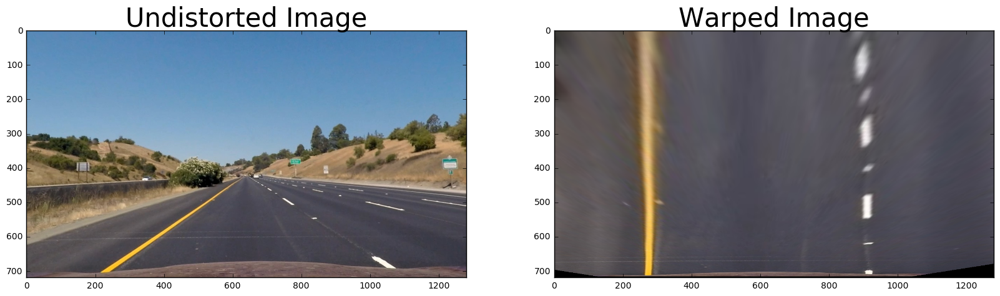

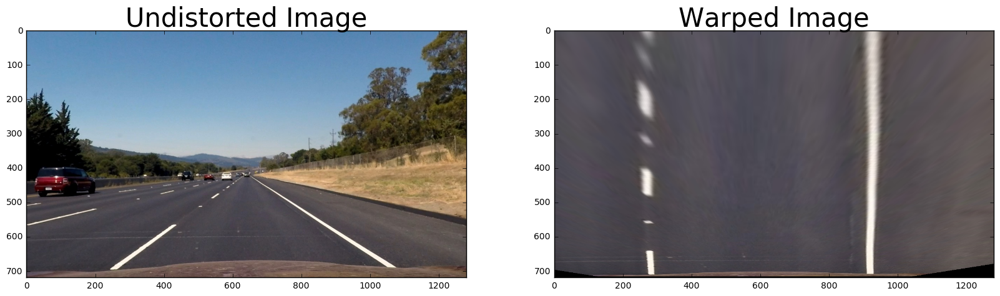

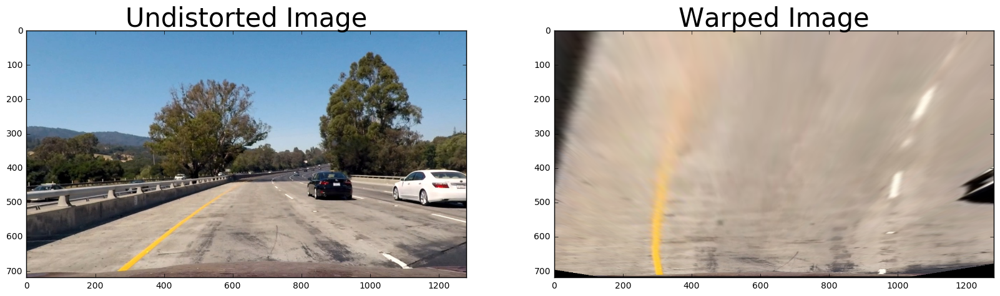

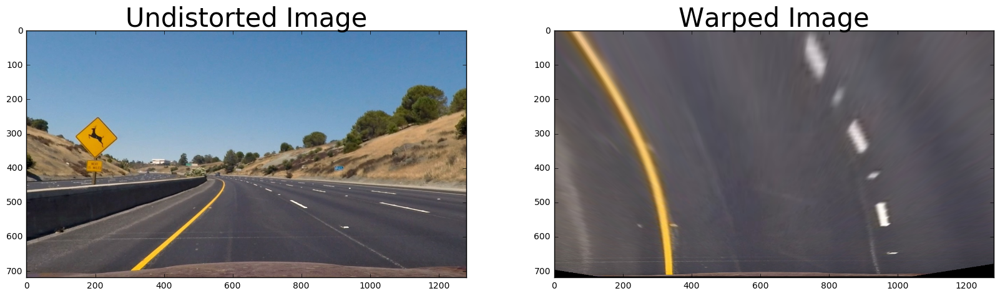

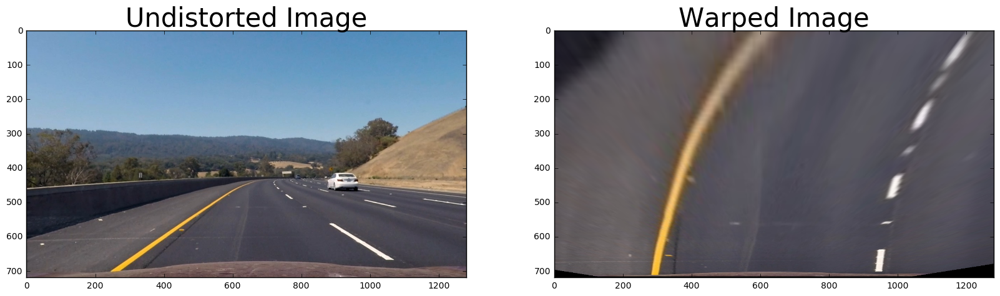

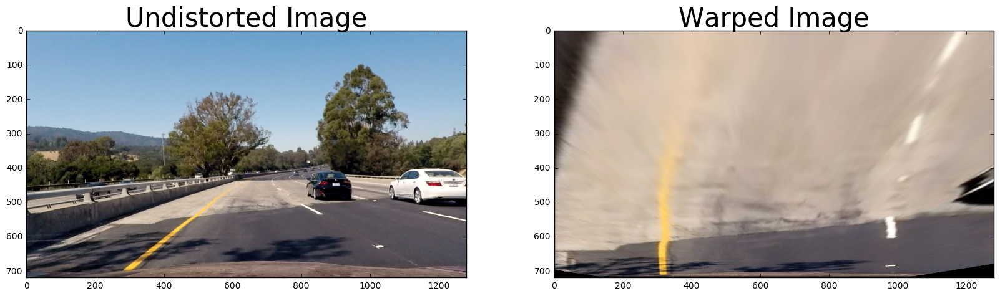

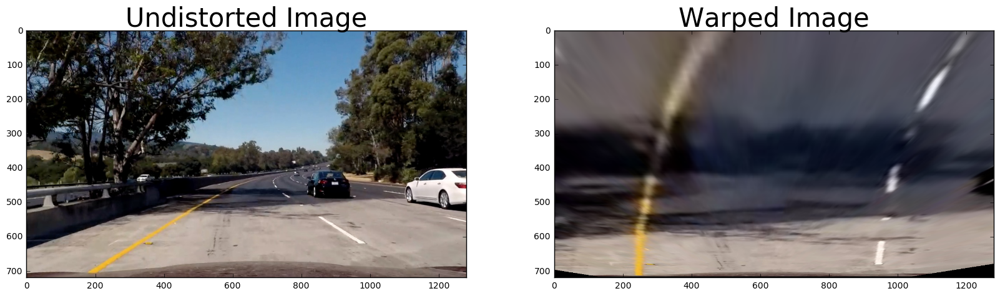

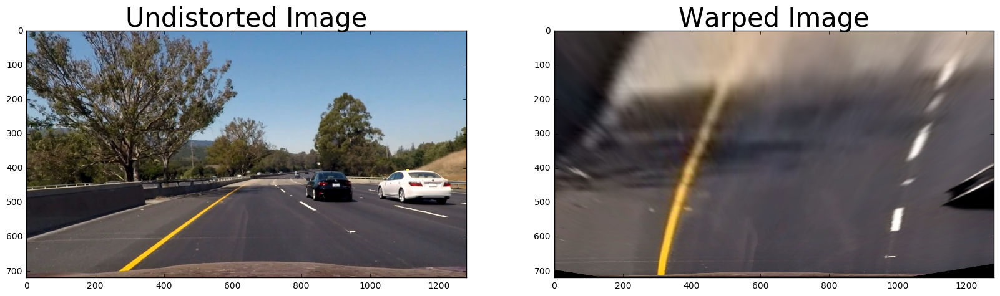

In [10]:
warped_images = []
for i in range(len(undist_images)):
    image = undist_images[i]
    warped_image = perspective_transform(image,drawLines=False)
    warped_images.append(warped_image)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/warped_test_images/'
    write_name = path+'warped'+str(i)+'.jpg'
    mpimg.imsave(write_name, image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(warped_image)
    ax2.set_title('Warped Image', fontsize=30)


## *Create combined threshold binary*

In [11]:
len(warped_images)

8

In [12]:
def lightness_saturation(img, s_thresh=(170, 255), sx_thresh=(20, 100),sy_thresh=(20,100)):
    img = np.copy(img)
    # Convert to HLS color space and separate L and S channels
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    l_channel = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)
    #l_channel = cv2.equalizeHist(l_channel.astype('uint8'))
    
    
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    sobely = cv2.Sobel(l_channel, cv2.CV_64F, 0, 1) # Take the derivative in y
    abs_sobely = np.absolute(sobely) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobely/np.max(abs_sobely))
    
    # Threshold y gradient
    #sybinary = np.zeros_like(scaled_sobel)
    #sybinary[(scaled_sobel >= sy_thresh[0]) | (scaled_sobel <= sy_thresh[1])] = 1
    
    #sxybinary = np.zeros_like(scaled_sobel)
    #sxybinary[(sxbinary == 1) | (sybinary == 1)] == 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    ls_binary =  np.zeros_like(sxbinary)
    ls_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return ls_binary

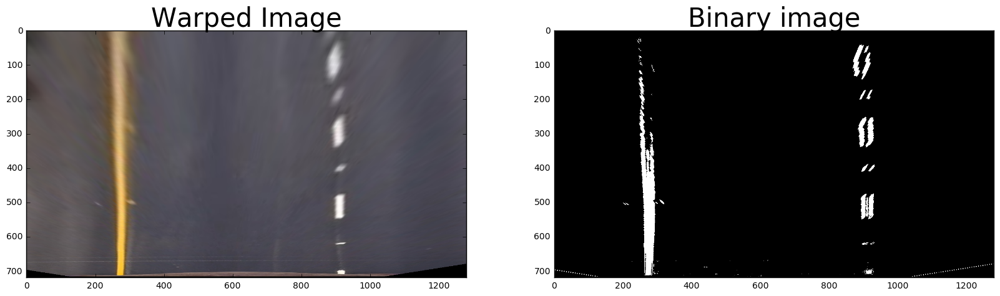

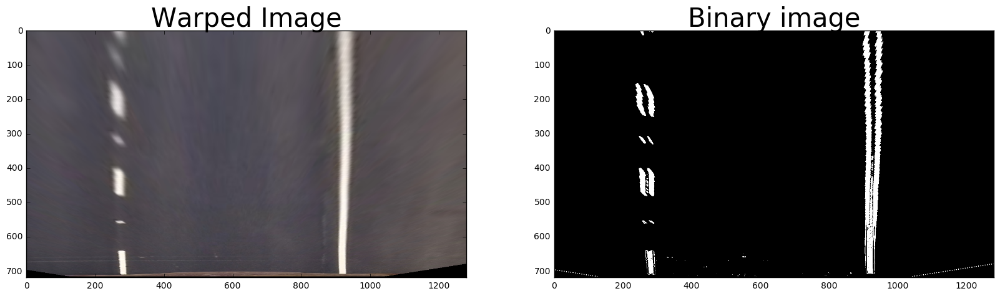

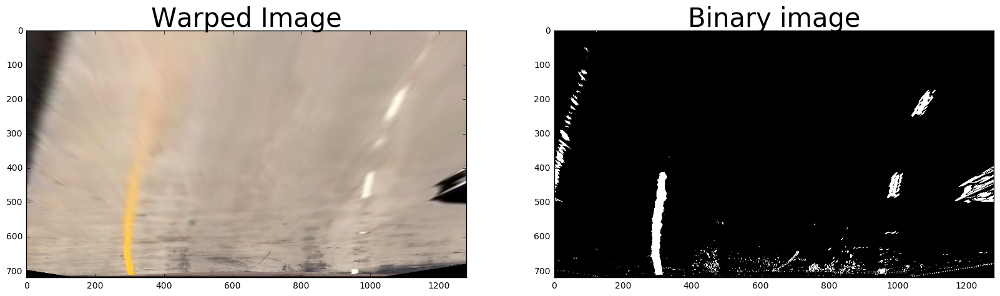

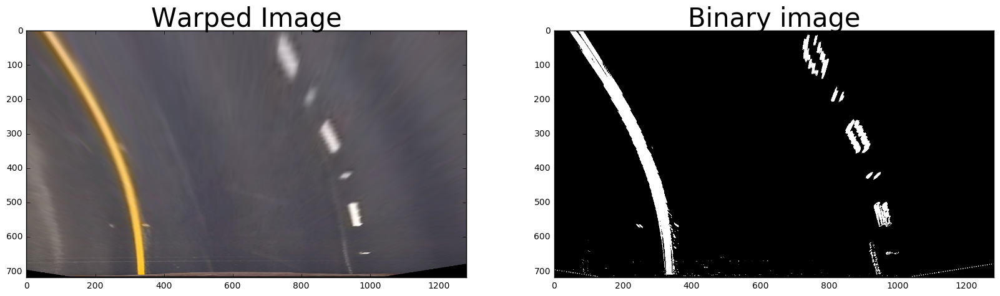

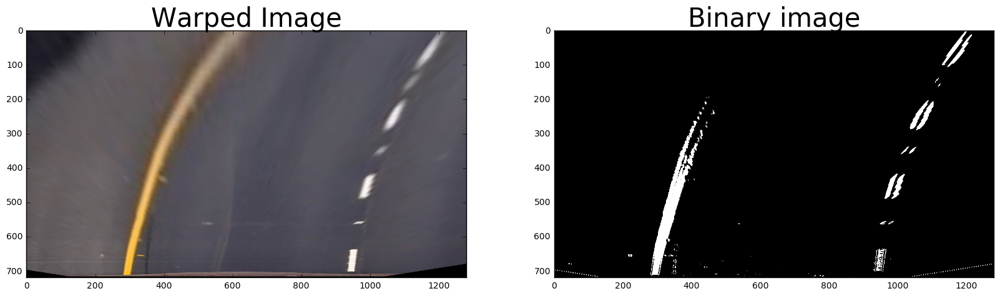

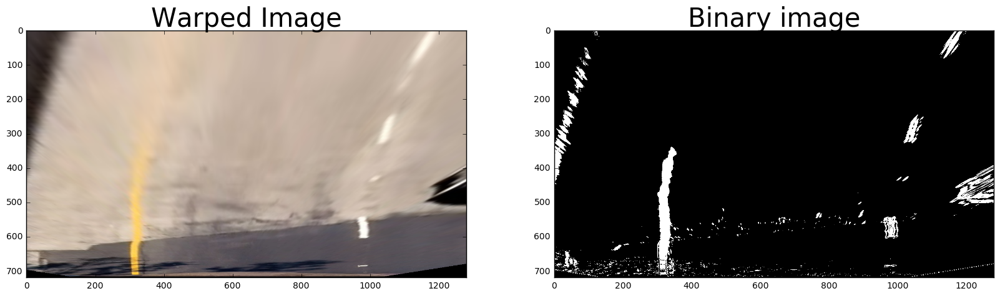

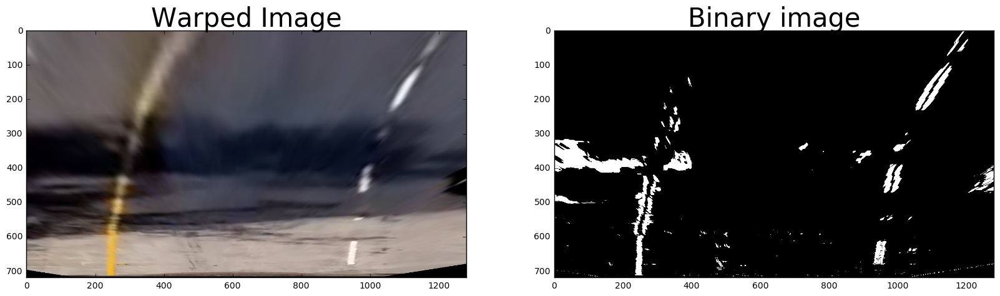

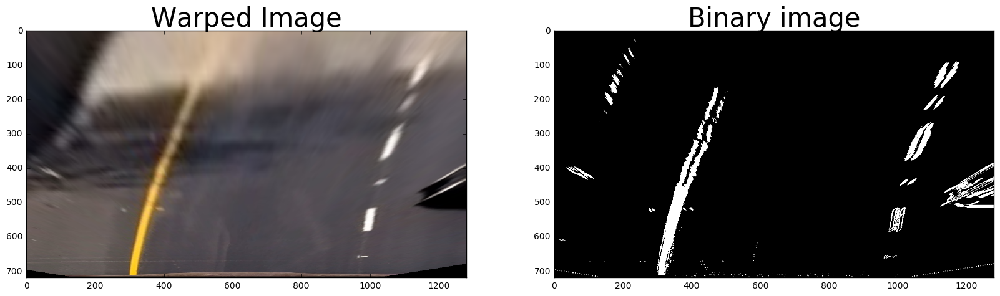

In [13]:
ls_binaries = []
for i in range(len(warped_images)):
    image = warped_images[i]
    ls_binary = lightness_saturation(image)
    ls_binaries.append(ls_binary)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/binary_test_images/'
    write_name = path+'binary'+str(i)+'.jpg'
    mpimg.imsave(write_name, ls_binary,cmap='gray')
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(ls_binary,cmap='gray')
    ax2.set_title('Binary image', fontsize=30)

## *Find out lane curves*

In [14]:
def lane_finder(binary_warped,debug=False):
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    #plt.plot(histogram)
    #plt.savefig('histogram.jpg')
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit,left_cov = np.polyfit(lefty, leftx, 2,cov=True)
    right_fit,right_cov = np.polyfit(righty, rightx, 2,cov=True)

    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    if (debug==True):
        
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
        
    
    return (left_fit,left_cov,right_fit,right_cov)

## *Find out lane curves based on history*

In [15]:
def lane_finder_from_past(binary_warped,left_fit,right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit,left_cov = np.polyfit(lefty, leftx, 2,cov=True)
    right_fit,right_cov = np.polyfit(righty, rightx, 2,cov=True)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return (left_fit,left_cov,right_fit,right_cov)

In [16]:
len(ls_binaries)

8

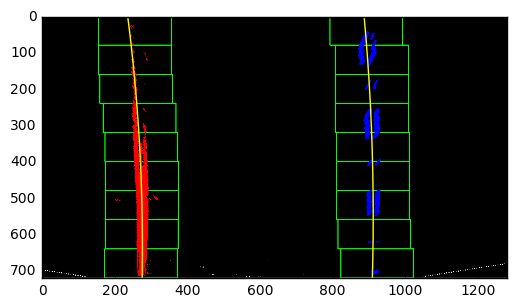

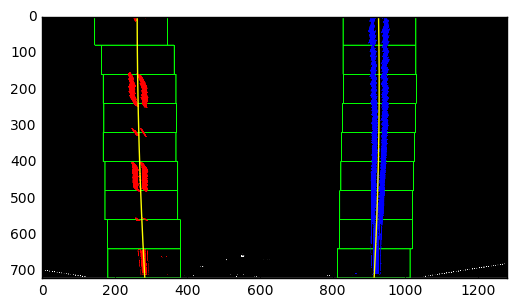

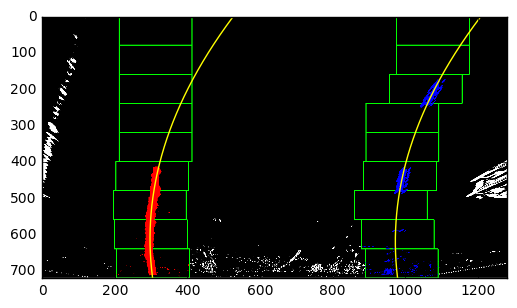

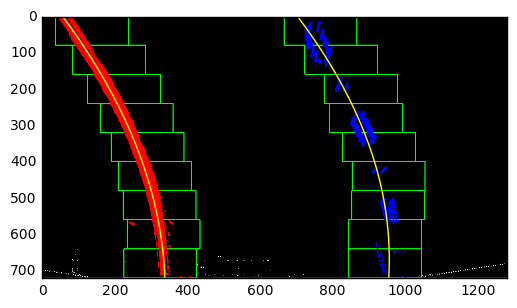

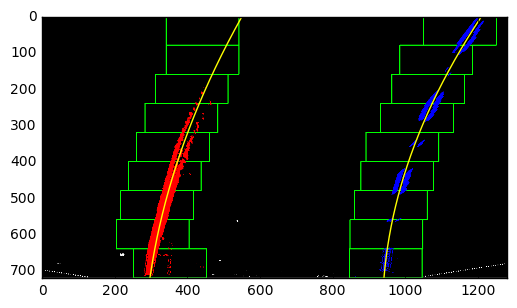

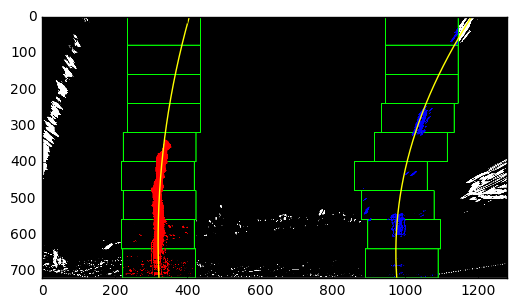

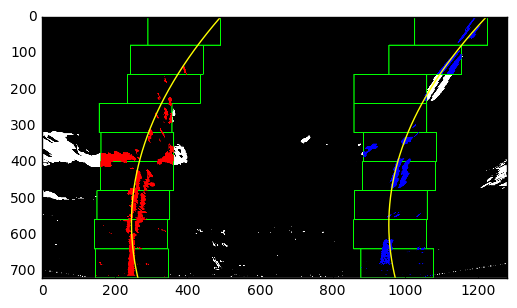

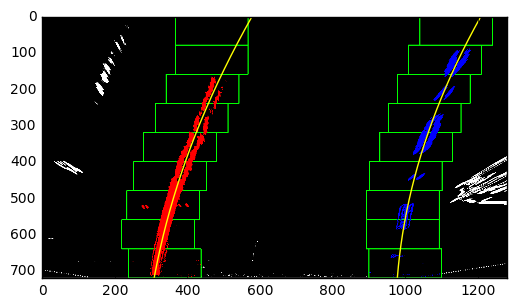

In [17]:
lanes=[]
for image in ls_binaries:
    left_fit,left_cov,right_fit,right_cov = lane_finder(image,debug=True)
    plt.figure()
    lanes.append([left_fit,right_fit])

In [18]:
# Not in use anymore, provides too much latency for lacking process noise(unknown host yar rate)
def Kalman_filter(lane,cov_lane,state,state_cov):
    global left_lane
    global right_lane
    global left_lane_cov
    global right_lane_cov
    if (state==None):
        state = lane
        state_cov = cov_lane
    else:
        residual = lane - state
        residual_cov = state_cov + cov_lane
        K = np.dot(state_cov,np.linalg.inv(residual_cov))
        state = state + np.dot(K,residual)
        state_cov = np.dot((np.eye(3) - K),state_cov)
    return state, state_cov

## *Buffer curve coefficents*

In [19]:
def buffering(coeffs,buff_index,buff_full,current_coeff):
    
    coeffs[buff_index,:] = current_coeff
    buff_index = buff_index + 1
    if buff_index == 10:
        buff_full = 1
        buff_index = 0
    
    return (coeffs,buff_index,buff_full)

## *Polygon to display fitted lane curves*

In [20]:
# This function returns a polygon in bird eye's view representing lane lines
def create_polygon(lane,image):
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )
    left_fit = lane[0]
    right_fit = lane[1]
    leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty  + left_fit[2]
    rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty  + right_fit[2]    
    mask = np.zeros_like(image)
    
    left_poly = np.dstack((leftx,ploty))
    right_poly = np.fliplr(np.dstack((rightx,ploty)))
    
    pts = np.hstack((left_poly,right_poly)).astype('int') # combination of all points from left and right lanes
    
    cv2.fillPoly(mask,pts,255)
    masked_image= cv2.bitwise_and(np.ones_like(image),mask)
    
    #return masked_image
    return np.dstack(( np.zeros_like(image),masked_image*255,np.zeros_like(image)))

In [21]:
filled_polys=[]
for lane in lanes:
    poly = create_polygon(lane,np.zeros_like(ls_binary))
    filled_polys.append(poly)

In [22]:
len(lanes)

8

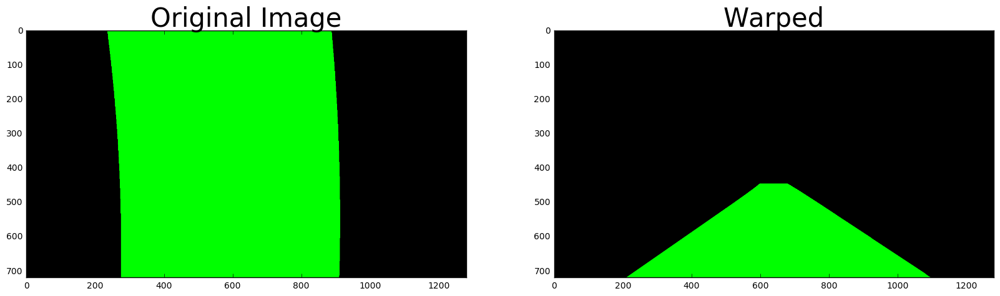

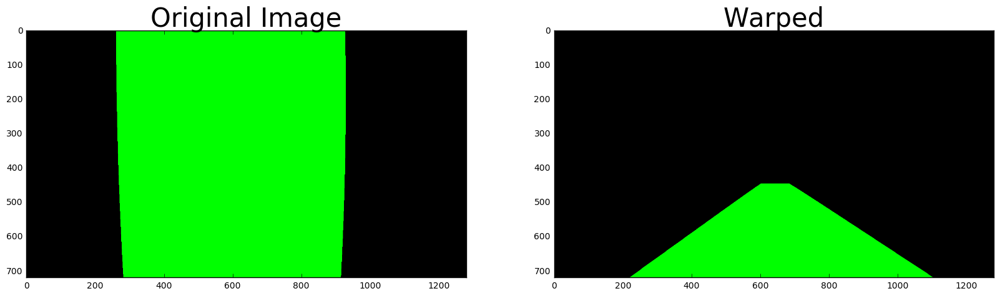

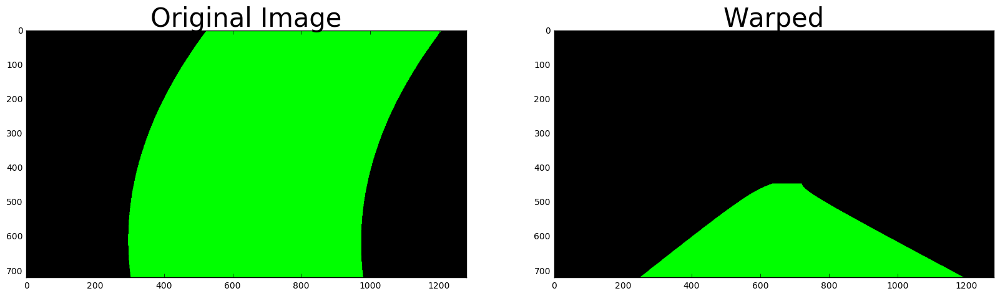

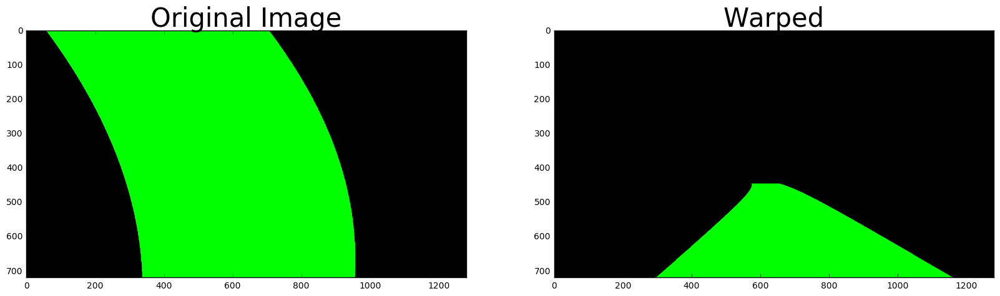

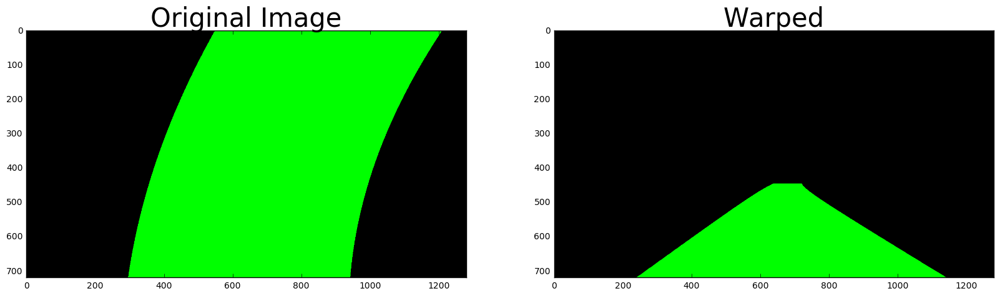

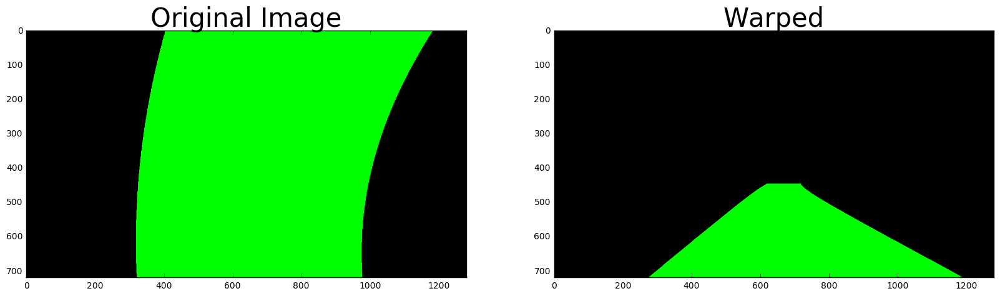

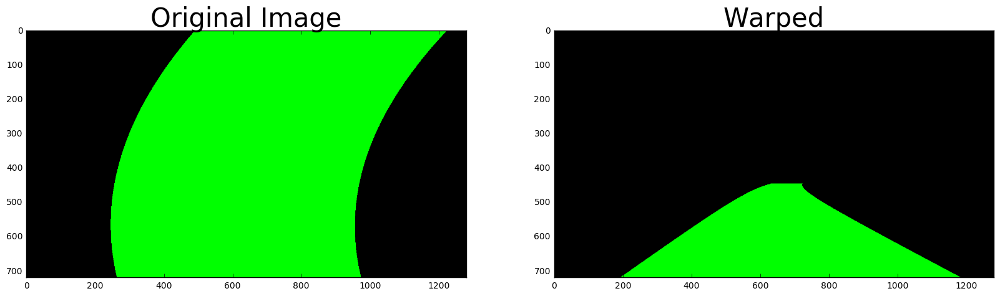

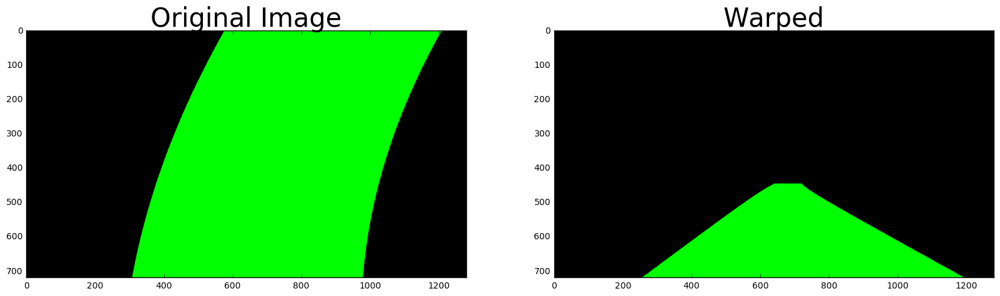

In [23]:
warped_polys = []
for i in range(len(filled_polys)):
    image = filled_polys[i]
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/polygons/'
    write_name = path+'polygon'+str(i)+'.jpg'
    mpimg.imsave(write_name, image)
    image2 = image.copy()
    image2 = perspective_transform(image,reverse=True)
    warped_polys.append(image2)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/polygons/'
    write_name = path+'warped_polygon'+str(i)+'.jpg'
    mpimg.imsave(write_name, image2)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(image2)
    ax2.set_title('Warped', fontsize=30)

## *Display the lane markings on the original image*

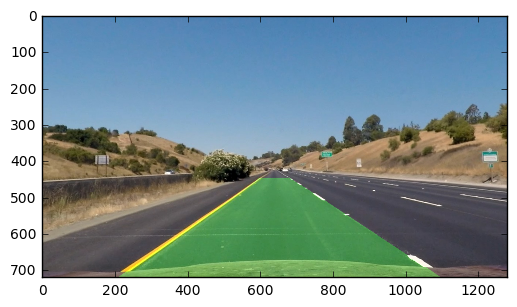

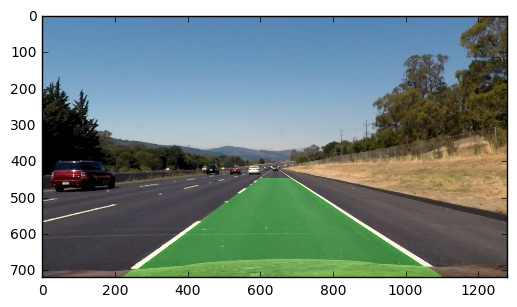

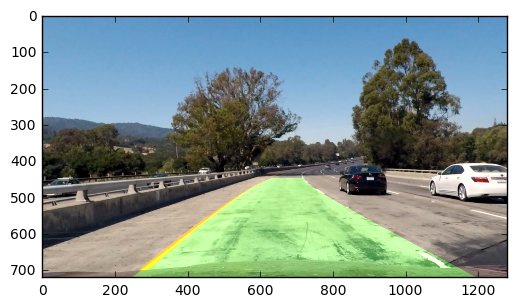

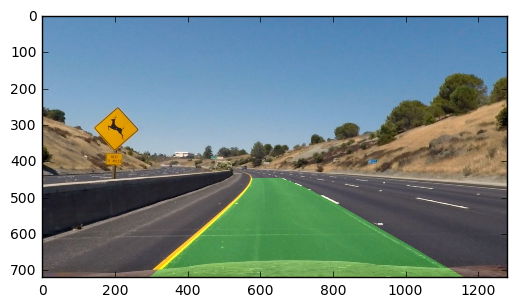

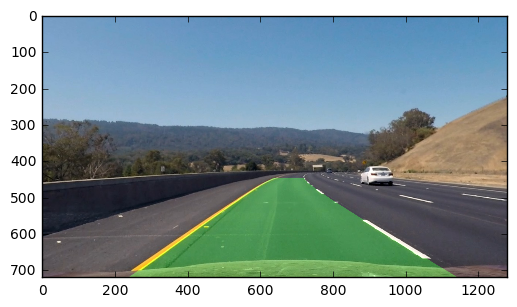

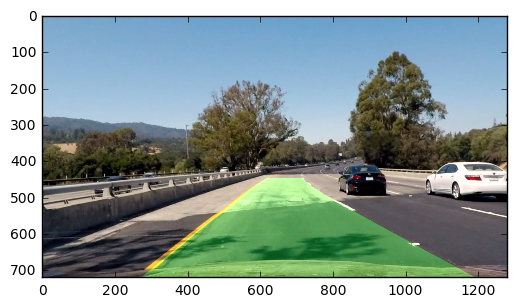

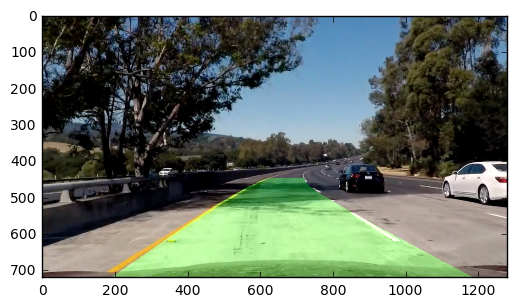

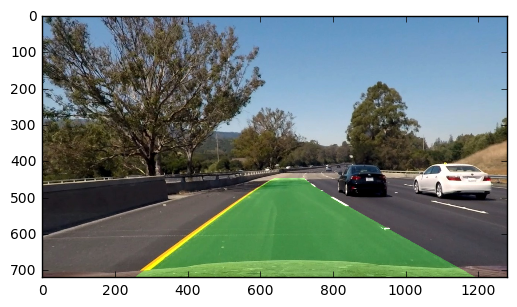

In [24]:
final_images=[]
for i in range(len(undist_images)):
  
    final_image = cv2.addWeighted(undist_images[i], 1, warped_polys[i], 0.3,  0.)
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/final_image/'
    write_name = path+'final_image'+str(i)+'.jpg'
    mpimg.imsave(write_name, final_image)
    #final_image = cv2.add(undist_images[i],warped_polys[i])
    final_images.append(final_image)
    plt.figure()
    plt.imshow(final_image)

## *Lane curvature in meters*

In [25]:
def find_curvature(lane,image):
    ploty = np.linspace(0, 719, num=720)
    left_fit = lane[0]
    right_fit = lane[1]
    leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty  + left_fit[2]
    rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty  + right_fit[2]    
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    y_eval = np.max(ploty)
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
   
    cam_wrt_road = ((leftx[int(y_eval)] + rightx[int(y_eval)])/2 - image.shape[1]/2)*xm_per_pix
    
    
    cv2.putText(image,'Left curvature %d (m)'%left_curverad,(850,50),cv2.FONT_HERSHEY_SIMPLEX, 1, [0, 0, 0], 2)
    cv2.putText(image,'Right curvature %d (m)'%right_curverad,(850,100),cv2.FONT_HERSHEY_SIMPLEX, 1, [0, 0, 0], 2)
    cv2.putText(image,'Camera w.r.t road: {0:.2f} m'.format(cam_wrt_road),(420,700),cv2.FONT_HERSHEY_SIMPLEX, 1, [0, 0, 0], 2)
    return image

## *Plausibility check for the lane curve coefficents*

In [26]:
def sanity_check(left_fit,to_buffer_left,right_fit,to_buffer_right):
    ploty = np.linspace(0, 719, num=720)
    
    leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty  + left_fit[2]
    rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty  + right_fit[2]    
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    y_eval = np.max(ploty)
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    if (left_curverad<200 or left_curverad>8000):
        to_buffer_left = False
        
    
    if (right_curverad<200 or right_curverad>8000):
        to_buffer_right = False
        
        
    return (to_buffer_left,to_buffer_right)

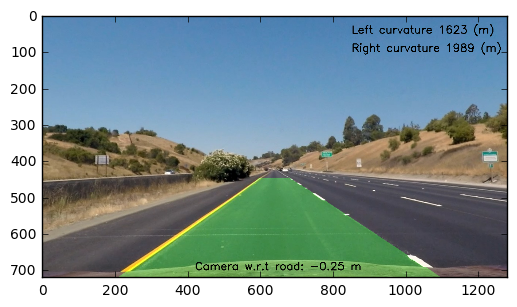

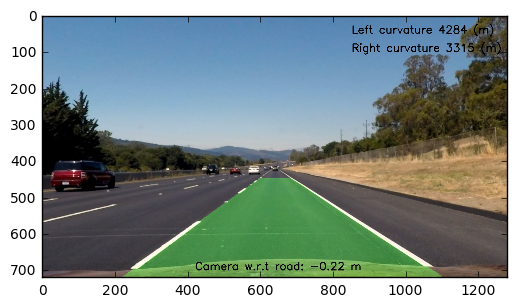

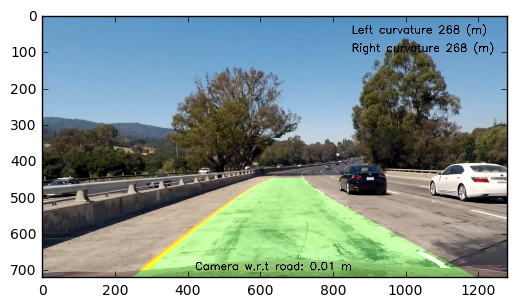

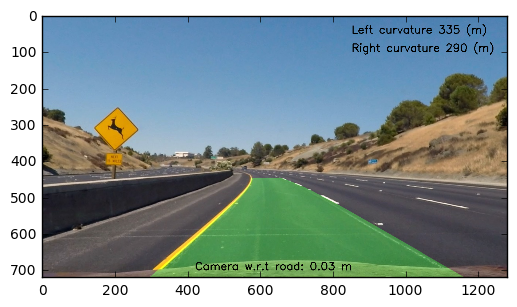

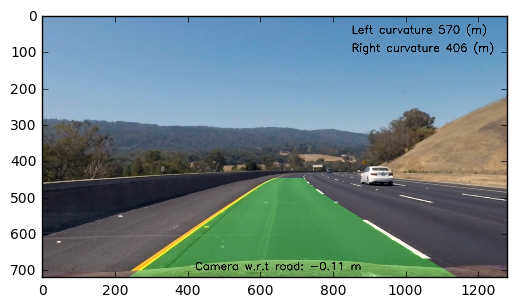

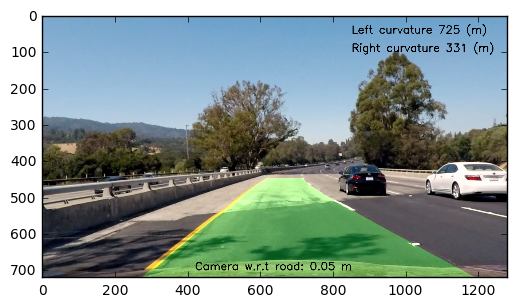

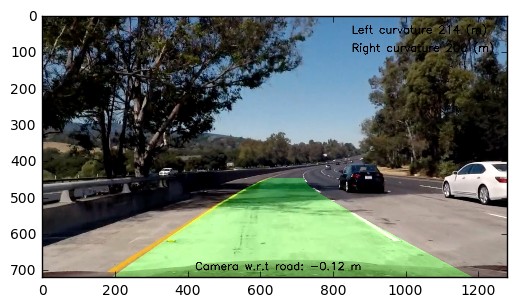

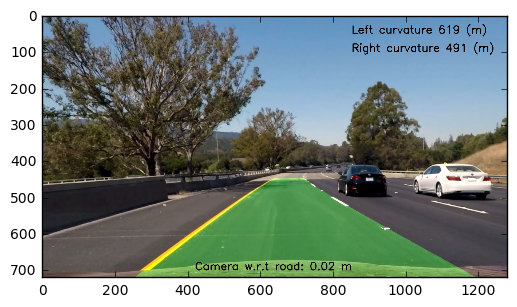

In [27]:
text_images = []
for i in range(len(final_images)):
    text_image = find_curvature(lanes[i],final_images[i])
    path = 'C:/Users/sbx1238/Documents/p4/CarND-Advanced-Lane-Lines/final_image_curvature/'
    write_name = path+'final_image_curvature'+str(i)+'.jpg'
    mpimg.imsave(write_name, text_image)
    text_images.append(text_image)
    plt.figure()
    plt.imshow(text_image)

## *Complete pipeline*

In [28]:
def process_image(image):
    
    global left_lane
    global avg_left_lane
    global left_buff_index
    global left_buff_full 

    global right_lane
    global avg_right_lane
    global right_buff_index
    global right_buff_full
    
    
    #print(np.sum(left_lane))
    #print(np.sum(right_lane))

    undist_image = cv2.undistort(image, mtx, dist, None, mtx)
    warped_image = perspective_transform(undist_image)
    ls_binary = lightness_saturation(warped_image)
    if (np.sum(left_lane)==0.0 and np.sum(right_lane)==0.0):
        left_fit,left_cov,right_fit,right_cov = lane_finder(ls_binary,debug=False)
    else:
        left_fit,left_cov,right_fit,right_cov = lane_finder_from_past(ls_binary,avg_left_lane,avg_right_lane)
    #print(left_fit)
    #print(left_cov)
    #print(right_fit)
    #print(right_cov)
    to_buffer_left = True
    to_buffer_right = True
    to_buffer_left,to_buffer_right = sanity_check(left_fit,to_buffer_left,right_fit,to_buffer_right)
    if (to_buffer_left==True):
        left_lane,left_buff_index,left_buff_full  = buffering(left_lane,left_buff_index,left_buff_full,left_fit)
        
    if left_buff_full == 1:
        denom = 10
    else:
        denom = left_buff_index
    avg_left_lane = np.sum(left_lane,axis=0)/denom
    #print(left_lane)
    #print(avg_left_lane)
    #left_lane,left_lane_cov = Kalman_filter(left_fit,left_cov,left_lane,left_lane_cov)
    #left_lane = a
    #left_lane_cov = b
    #right_lane,right_lane_cov = Kalman_filter(right_fit,right_cov,right_lane,right_lane_cov)
    #right_lane = c
    #right_lane_cov = d
    
    if (to_buffer_right==True):
        right_lane,right_buff_index,right_buff_full  = buffering(right_lane,right_buff_index,right_buff_full,right_fit)
        
    if right_buff_full == 1:
        denom = 10
    else:
         denom = right_buff_index
    avg_right_lane = np.sum(right_lane,axis=0)/denom
    #print(right_lane)
    #print(avg_right_lane)
    
    poly = create_polygon([avg_left_lane,avg_right_lane],np.zeros_like(ls_binary))
    image2 = perspective_transform(poly,reverse=True)
    final_image = cv2.addWeighted(undist_image, 1, image2, 0.3,  0.)
    text_image = find_curvature([avg_left_lane,avg_right_lane],final_image)
    return text_image
    #print(np.max(image))
    #print(np.min(image))
    #print(image.shape)
    #return image

## *Processing video stream*

In [29]:
global left_lane
global avg_left_lane
global left_buff_index
global left_buff_full 

global right_lane
global avg_right_lane
global right_buff_index
global right_buff_full 

left_lane = np.zeros((10,3))
avg_left_lane = None
left_buff_full = 0
left_buff_index=0
    
right_lane = np.zeros((10,3))
avg_right_lane = None
right_buff_full = 0
right_buff_index=0

project_output_file = "project_output.mp4"
project_video = VideoFileClip(r"C:\Users\sbx1238\Documents\p4\CarND-Advanced-Lane-Lines\project_video.mp4")

project_output = project_video.fl_image(process_image)
%time project_output.write_videofile(project_output_file, audio=False)

[MoviePy] >>>> Building video project_output.mp4
[MoviePy] Writing video project_output.mp4


100%|█████████████████████████████████████▉| 1260/1261 [04:15<00:00,  4.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_output.mp4 

Wall time: 4min 17s
